<a href="https://colab.research.google.com/github/andrewedbert/Material/blob/main/Case_Study_3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install pycaret

     |████████████████████████████████| 288 kB 5.1 MB/s 
     |████████████████████████████████| 16.9 MB 165 kB/s 
     |████████████████████████████████| 113 kB 41.2 MB/s 
     |████████████████████████████████| 6.8 MB 15.0 MB/s 
     |████████████████████████████████| 1.3 MB 62.6 MB/s 
     |████████████████████████████████| 261 kB 43.2 MB/s 
     |████████████████████████████████| 2.0 MB 45.0 MB/s 
     |████████████████████████████████| 86 kB 5.4 MB/s 
     |████████████████████████████████| 167 kB 50.2 MB/s 
     |████████████████████████████████| 1.7 MB 53.8 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 56 kB 4.2 MB/s 
     |████████████████████████████████| 62 kB 734 kB/s 
     |████████████████████████████████| 596 kB 62.8 MB/s 
     |████████████████████████████████| 102 kB 11.7 MB/s 
     |████████████████████

In [2]:
import pandas as pd
import numpy as np
from pycaret.classification import *
from pycaret.utils import check_metric

In [3]:
data = pd.read_csv('Data_Takers.csv')
data.shape

(72709, 53)

In [4]:
data.head()

,ID,Year_Birth,Education,Marital_Status,DT_Cust,Dependant,Income,Saving_Balance,Giro_Balance,Time_Deposit_Balance,AUM_Balance,Cnt_ATM_In,Vol_ATM_In,Cnt_ATM_Out,Vol_ATM_Out,Cnt_Branch_In,Vol_Branch_In,Cnt_Branch_Out,Vol_Branch_Out,Own_CC,Cnt_CC_Usage,Vol_CC_Usage,Own_PL,PL_Outstanding,Own_Mortgage,Mortgage_Outstanding,Own_Autoloan,Autoloan_Outstanding,Own_MPL,MPL_Outstanding,Have_Gomo,Active_Gomo,Cnt_Trx_Gomo,Vol_Trx_Gomo,Have_Clicks,Active_Clicks,Cnt_Trx_Clicks,Vol_Trx_Clicks,Cnt_Trx_FX,Vol_Trx_FX,AcceptCamp1,AcceptCamp2,AcceptCamp3,AcceptCamp4,AcceptCamp5,AcceptCamp6,AcceptCamp7,AcceptCamp8,AcceptCamp9,AcceptCamp10,AcceptCamp11,AcceptCamp12,Takers
0,1514267,1989,Undergraduate,Single,2007-04-26,1,1.206930e+07,8.150154e+06,0.000000e+00,0.0,3.293772e+07,17,1.002427e+06,6,618736.604865,3,2.690609e+06,5,3.690387e+06,0,0.000000,0.0,1.0,1.195442e+06,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,15.0,9.520955e+05,1.0,0.0,0.0,0.000000e+00,3.0,7.274822e+06,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0
1,1511237,1974,SMA,Married,2007-12-04,3,1.075816e+07,4.153613e+06,0.000000e+00,0.0,5.510467e+06,19,6.586090e+05,3,387599.751011,1,4.902960e+06,4,3.158412e+06,0,0.000000,0.0,1.0,9.974157e+06,0.0,0.0,1.0,8.520078e+06,0.0,0.000000e+00,1.0,1.0,12.0,3.480319e+06,1.0,1.0,4.0,1.488400e+06,8.0,7.173206e+06,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0
2,1457996,1988,SMA,Single,2001-10-12,3,4.625002e+06,3.144936e+07,7.439194e+06,0.0,2.162504e+06,16,3.159343e+05,1,734581.143239,0,0.000000e+00,2,2.893038e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,1.0,4.667815e+05,1.0,1.0,14.0,1.901776e+06,0.0,0.000000e+00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0
3,1475476,1990,PhD,Married,2007-04-07,1,4.341001e+06,1.314961e+07,7.257356e+06,0.0,1.599004e+07,13,9.026058e+05,18,616578.608686,1,1.544454e+06,3,4.022116e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,1.0,1.0,17.0,2.219176e+06,4.0,7.079773e+06,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0
4,1512146,1962,SMA,Married,2017-01-10,4,8.927780e+06,4.482012e+06,4.261244e+07,0.0,1.815716e+07,3,4.925973e+05,19,681514.542887,4,3.469278e+06,4,1.331248e+06,1,572779.984736,11.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,9.332583e+06,1.0,1.0,18.0,3.434223e+05,1.0,1.0,20.0,4.167771e+06,1.0,6.609663e+06,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0


In [5]:
import datetime

In [6]:
data['age']=2021-data['Year_Birth']
data.head()

,ID,Year_Birth,Education,Marital_Status,DT_Cust,Dependant,Income,Saving_Balance,Giro_Balance,Time_Deposit_Balance,AUM_Balance,Cnt_ATM_In,Vol_ATM_In,Cnt_ATM_Out,Vol_ATM_Out,Cnt_Branch_In,Vol_Branch_In,Cnt_Branch_Out,Vol_Branch_Out,Own_CC,Cnt_CC_Usage,Vol_CC_Usage,Own_PL,PL_Outstanding,Own_Mortgage,Mortgage_Outstanding,Own_Autoloan,Autoloan_Outstanding,Own_MPL,MPL_Outstanding,Have_Gomo,Active_Gomo,Cnt_Trx_Gomo,Vol_Trx_Gomo,Have_Clicks,Active_Clicks,Cnt_Trx_Clicks,Vol_Trx_Clicks,Cnt_Trx_FX,Vol_Trx_FX,AcceptCamp1,AcceptCamp2,AcceptCamp3,AcceptCamp4,AcceptCamp5,AcceptCamp6,AcceptCamp7,AcceptCamp8,AcceptCamp9,AcceptCamp10,AcceptCamp11,AcceptCamp12,Takers,age
0,1514267,1989,Undergraduate,Single,2007-04-26,1,1.206930e+07,8.150154e+06,0.000000e+00,0.0,3.293772e+07,17,1.002427e+06,6,618736.604865,3,2.690609e+06,5,3.690387e+06,0,0.000000,0.0,1.0,1.195442e+06,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,15.0,9.520955e+05,1.0,0.0,0.0,0.000000e+00,3.0,7.274822e+06,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,32
1,1511237,1974,SMA,Married,2007-12-04,3,1.075816e+07,4.153613e+06,0.000000e+00,0.0,5.510467e+06,19,6.586090e+05,3,387599.751011,1,4.902960e+06,4,3.158412e+06,0,0.000000,0.0,1.0,9.974157e+06,0.0,0.0,1.0,8.520078e+06,0.0,0.000000e+00,1.0,1.0,12.0,3.480319e+06,1.0,1.0,4.0,1.488400e+06,8.0,7.173206e+06,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,47
2,1457996,1988,SMA,Single,2001-10-12,3,4.625002e+06,3.144936e+07,7.439194e+06,0.0,2.162504e+06,16,3.159343e+05,1,734581.143239,0,0.000000e+00,2,2.893038e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,1.0,4.667815e+05,1.0,1.0,14.0,1.901776e+06,0.0,0.000000e+00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,33
3,1475476,1990,PhD,Married,2007-04-07,1,4.341001e+06,1.314961e+07,7.257356e+06,0.0,1.599004e+07,13,9.026058e+05,18,616578.608686,1,1.544454e+06,3,4.022116e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,1.0,1.0,17.0,2.219176e+06,4.0,7.079773e+06,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,31
4,1512146,1962,SMA,Married,2017-01-10,4,8.927780e+06,4.482012e+06,4.261244e+07,0.0,1.815716e+07,3,4.925973e+05,19,681514.542887,4,3.469278e+06,4,1.331248e+06,1,572779.984736,11.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,9.332583e+06,1.0,1.0,18.0,3.434223e+05,1.0,1.0,20.0,4.167771e+06,1.0,6.609663e+06,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,59


In [7]:
data['DT_form_date']=pd.to_datetime(data['DT_Cust'],format='%Y-%m-%d')
from datetime import date, timedelta
from dateutil.relativedelta import relativedelta

In [8]:
today = date.today()

In [9]:
data['today']='2021-11-19'
data.head()

,ID,Year_Birth,Education,Marital_Status,DT_Cust,Dependant,Income,Saving_Balance,Giro_Balance,Time_Deposit_Balance,AUM_Balance,Cnt_ATM_In,Vol_ATM_In,Cnt_ATM_Out,Vol_ATM_Out,Cnt_Branch_In,Vol_Branch_In,Cnt_Branch_Out,Vol_Branch_Out,Own_CC,Cnt_CC_Usage,Vol_CC_Usage,Own_PL,PL_Outstanding,Own_Mortgage,Mortgage_Outstanding,Own_Autoloan,Autoloan_Outstanding,Own_MPL,MPL_Outstanding,Have_Gomo,Active_Gomo,Cnt_Trx_Gomo,Vol_Trx_Gomo,Have_Clicks,Active_Clicks,Cnt_Trx_Clicks,Vol_Trx_Clicks,Cnt_Trx_FX,Vol_Trx_FX,AcceptCamp1,AcceptCamp2,AcceptCamp3,AcceptCamp4,AcceptCamp5,AcceptCamp6,AcceptCamp7,AcceptCamp8,AcceptCamp9,AcceptCamp10,AcceptCamp11,AcceptCamp12,Takers,age,DT_form_date,today
0,1514267,1989,Undergraduate,Single,2007-04-26,1,1.206930e+07,8.150154e+06,0.000000e+00,0.0,3.293772e+07,17,1.002427e+06,6,618736.604865,3,2.690609e+06,5,3.690387e+06,0,0.000000,0.0,1.0,1.195442e+06,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,15.0,9.520955e+05,1.0,0.0,0.0,0.000000e+00,3.0,7.274822e+06,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,32,2007-04-26,2021-11-19
1,1511237,1974,SMA,Married,2007-12-04,3,1.075816e+07,4.153613e+06,0.000000e+00,0.0,5.510467e+06,19,6.586090e+05,3,387599.751011,1,4.902960e+06,4,3.158412e+06,0,0.000000,0.0,1.0,9.974157e+06,0.0,0.0,1.0,8.520078e+06,0.0,0.000000e+00,1.0,1.0,12.0,3.480319e+06,1.0,1.0,4.0,1.488400e+06,8.0,7.173206e+06,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0,47,2007-12-04,2021-11-19
2,1457996,1988,SMA,Single,2001-10-12,3,4.625002e+06,3.144936e+07,7.439194e+06,0.0,2.162504e+06,16,3.159343e+05,1,734581.143239,0,0.000000e+00,2,2.893038e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,1.0,4.667815e+05,1.0,1.0,14.0,1.901776e+06,0.0,0.000000e+00,0.0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,33,2001-10-12,2021-11-19
3,1475476,1990,PhD,Married,2007-04-07,1,4.341001e+06,1.314961e+07,7.257356e+06,0.0,1.599004e+07,13,9.026058e+05,18,616578.608686,1,1.544454e+06,3,4.022116e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,1.0,1.0,17.0,2.219176e+06,4.0,7.079773e+06,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,31,2007-04-07,2021-11-19
4,1512146,1962,SMA,Married,2017-01-10,4,8.927780e+06,4.482012e+06,4.261244e+07,0.0,1.815716e+07,3,4.925973e+05,19,681514.542887,4,3.469278e+06,4,1.331248e+06,1,572779.984736,11.0,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,9.332583e+06,1.0,1.0,18.0,3.434223e+05,1.0,1.0,20.0,4.167771e+06,1.0,6.609663e+06,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,59,2017-01-10,2021-11-19


In [10]:
data['today_form_date']=pd.to_datetime(data['today'],format='%Y-%m-%d')
data['mob_days']=(data['today_form_date'] - data['DT_form_date']).dt.days
data['mob_months']=data['mob_days'].astype(int)/30
del data['today_form_date']
del data['today']

In [11]:
data1 = pd.get_dummies(data,prefix=['Education'], columns = ['Education'], drop_first=True)
data2 = pd.get_dummies(data1,prefix=['Marital_Status'], columns = ['Marital_Status'], drop_first=True)
del data2['Year_Birth']
del data2['DT_Cust']
del data2['DT_form_date']
del data2['ID']

In [12]:
data = data2.sample(frac=0.9, random_state=786)
data_unseen = data2.drop(data.index)

data.reset_index(drop=True, inplace=True)
data_unseen.reset_index(drop=True, inplace=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

Data for Modeling: (65438, 59)
Unseen Data For Predictions: (7271, 59)


In [ ]:
from pycaret.clustering import *

exp_clu101 = setup(data, normalize = True, 
#                    ignore_features = ['CUST_ID'],
                   session_id = 123)

IntProgress(value=0, description='Processing: ', max=3)

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,02:01:54
Status,. . . . . . . . . . . . . . . . . .,Preprocessing Data


Text(value="Following data types have been inferred automatically, if they are correct press enter to continue…

,Data Type
Dependant,
Income,Numeric
Saving_Balance,Numeric
Giro_Balance,Numeric
Time_Deposit_Balance,Numeric
AUM_Balance,Numeric
Cnt_ATM_In,
Vol_ATM_In,Numeric
Cnt_ATM_Out,
Vol_ATM_Out,Numeric


In [14]:
kmeans = create_model('kmeans')

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.5695,325434.654,0.5037,0,0,0


In [15]:
print(kmeans)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)


In [16]:
print(kmeans)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
       n_clusters=4, n_init=10, n_jobs=-1, precompute_distances='deprecated',
       random_state=123, tol=0.0001, verbose=0)


In [17]:
models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch
kmodes,K-Modes Clustering,kmodes.kmodes.KModes


In [18]:
kmodes = create_model('kmodes', num_clusters = 4)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,-0.0054,1.5253,970.2545,0,0,0


In [19]:
print(kmodes)

KModes(cat_dissim=<function matching_dissim at 0x7efe8f3ee830>, init='Cao',
       max_iter=100, n_clusters=4, n_init=1, n_jobs=-1, random_state=123,
       verbose=0)


In [20]:
kmean_results = assign_model(kmeans)
kmean_results.head()

,Dependant,Income,Saving_Balance,Giro_Balance,Time_Deposit_Balance,AUM_Balance,Cnt_ATM_In,Vol_ATM_In,Cnt_ATM_Out,Vol_ATM_Out,Cnt_Branch_In,Vol_Branch_In,Cnt_Branch_Out,Vol_Branch_Out,Own_CC,Cnt_CC_Usage,Vol_CC_Usage,Own_PL,PL_Outstanding,Own_Mortgage,Mortgage_Outstanding,Own_Autoloan,Autoloan_Outstanding,Own_MPL,MPL_Outstanding,Have_Gomo,Active_Gomo,Cnt_Trx_Gomo,Vol_Trx_Gomo,Have_Clicks,Active_Clicks,Cnt_Trx_Clicks,Vol_Trx_Clicks,Cnt_Trx_FX,Vol_Trx_FX,AcceptCamp1,AcceptCamp2,AcceptCamp3,AcceptCamp4,AcceptCamp5,AcceptCamp6,AcceptCamp7,AcceptCamp8,AcceptCamp9,AcceptCamp10,AcceptCamp11,AcceptCamp12,Takers,age,mob_days,mob_months,Education_PhD,Education_SMA,Education_SMP,Education_Undergraduate,Marital_Status_Married,Marital_Status_Others,Marital_Status_Single,Marital_Status_Widowed,Cluster
0,2,4.558636e+06,6.312224e+07,4.221233e+06,0.0,4.344839e+06,0,0.000000,8,273640.313295,5,1.416581e+06,2,1.650519e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,1.0,8.034626e+06,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,75,3471,115.700000,0,0,0,0,1,0,0,0,Cluster 3
1,4,2.209540e+07,7.496082e+07,3.500419e+07,0.0,2.226903e+06,16,939249.302571,19,588797.842480,1,8.955417e+05,3,1.577410e+06,1,463849.297154,5.0,1.0,8.490085e+06,0.0,0.000000e+00,0.0,0.000000e+00,1.0,8.846523e+06,1.0,1.0,10.0,3.509927e+06,1.0,1.0,19.0,1.072143e+06,4.0,8.199059e+06,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,60,6477,215.900000,0,0,0,1,1,0,0,0,Cluster 2
2,3,1.086890e+07,5.480122e+07,0.000000e+00,0.0,3.053315e+06,10,809443.749651,15,523248.976230,3,7.064752e+06,4,2.996320e+06,1,282105.405073,18.0,0.0,0.000000e+00,1.0,1.302971e+08,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.0,18.0,4.777585e+06,0.0,0.0,0.0,0.000000e+00,10.0,4.337423e+06,0.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,39,7574,252.466667,0,1,0,0,1,0,0,0,Cluster 2
3,5,2.189210e+07,5.030434e+07,4.384570e+07,0.0,2.485632e+07,13,298124.677843,1,651838.675514,1,1.124454e+06,5,3.416745e+06,0,0.000000,0.0,1.0,5.886523e+06,0.0,0.000000e+00,1.0,8.729409e+06,0.0,0.000000e+00,1.0,1.0,15.0,2.354112e+06,0.0,0.0,0.0,0.000000e+00,1.0,9.319299e+06,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,77,2720,90.666667,0,0,1,0,0,0,1,0,Cluster 3
4,5,6.316243e+06,3.235682e+07,0.000000e+00,0.0,7.976840e+06,11,684676.119002,17,180696.951290,2,3.916988e+06,5,1.592518e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,1.0,7.331930e+06,1.0,1.0,15.0,4.667867e+06,1.0,1.0,5.0,1.554577e+06,2.0,5.668880e+06,0.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,51,380,12.666667,0,0,0,1,0,0,1,0,Cluster 1


In [21]:
plot_model(kmeans)

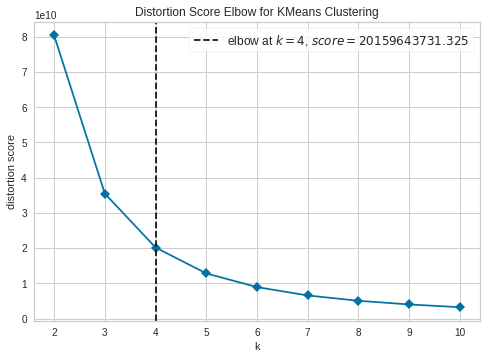

In [22]:
plot_model(kmeans, plot = 'elbow')

In [23]:
kmeans5 = create_model('kmeans', num_clusters = 5)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.5606,393680.5183,0.502,0,0,0


In [24]:
plot_model(kmeans5)

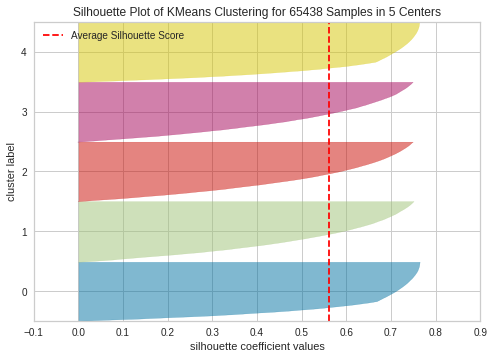

In [25]:
plot_model(kmeans5, plot = 'silhouette')

In [26]:
plot_model(kmeans5, plot = 'distribution') #to see size of clusters

In [27]:
unseen_predictions = predict_model(kmeans5, data=data_unseen)
unseen_predictions.head()

,Dependant,Income,Saving_Balance,Giro_Balance,Time_Deposit_Balance,AUM_Balance,Cnt_ATM_In,Vol_ATM_In,Cnt_ATM_Out,Vol_ATM_Out,Cnt_Branch_In,Vol_Branch_In,Cnt_Branch_Out,Vol_Branch_Out,Own_CC,Cnt_CC_Usage,Vol_CC_Usage,Own_PL,PL_Outstanding,Own_Mortgage,Mortgage_Outstanding,Own_Autoloan,Autoloan_Outstanding,Own_MPL,MPL_Outstanding,Have_Gomo,Active_Gomo,Cnt_Trx_Gomo,Vol_Trx_Gomo,Have_Clicks,Active_Clicks,Cnt_Trx_Clicks,Vol_Trx_Clicks,Cnt_Trx_FX,Vol_Trx_FX,AcceptCamp1,AcceptCamp2,AcceptCamp3,AcceptCamp4,AcceptCamp5,AcceptCamp6,AcceptCamp7,AcceptCamp8,AcceptCamp9,AcceptCamp10,AcceptCamp11,AcceptCamp12,Takers,age,mob_days,mob_months,Education_PhD,Education_SMA,Education_SMP,Education_Undergraduate,Marital_Status_Married,Marital_Status_Others,Marital_Status_Single,Marital_Status_Widowed,Cluster
0,5,2.979015e+06,6.228561e+06,0.0,0.0,5.189628e+07,15,604321.272979,6,288085.094619,2,1.195657e+06,2,1.762718e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.691425e+06,0.0,0.000000e+00,1.0,1.0,20.0,3.949848e+06,1.0,1.0,0.0,0.000000e+00,4.0,5.674892e+06,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,51,426,14.200000,0,0,0,1,0,0,1,0,Cluster 4
1,0,2.670770e+07,6.433055e+07,0.0,0.0,2.045548e+07,10,394840.060184,5,586978.349246,5,1.981632e+06,5,5.276969e+06,0,0.000000,0.0,1.0,3.824318e+06,0.0,0.000000e+00,0.0,0.000000e+00,1.0,4.859577e+06,1.0,1.0,12.0,2.047387e+06,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,42,2027,67.566667,0,0,0,1,1,0,0,0,Cluster 2
2,5,1.028139e+07,3.420415e+07,0.0,0.0,6.130568e+06,13,297557.841604,10,175535.427389,5,2.561147e+06,3,6.301960e+05,1,546120.353904,6.0,1.0,1.161323e+06,1.0,1.472688e+08,0.0,0.000000e+00,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,1.0,1.0,19.0,3.316912e+06,4.0,6.934436e+06,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,44,5859,195.300000,0,0,0,1,0,0,1,0,Cluster 3
3,2,9.587614e+06,1.587520e+07,0.0,0.0,3.500334e+07,6,380632.454453,0,0.000000,3,2.713329e+06,5,1.138784e+06,1,442516.559724,17.0,1.0,1.767888e+06,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,1.0,16.0,2.263583e+06,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,65,6184,206.133333,0,1,0,0,1,0,0,0,Cluster 3
4,4,2.878008e+06,4.228124e+06,0.0,0.0,1.000465e+07,4,423326.674481,0,0.000000,3,1.551825e+06,3,1.313073e+06,1,453745.441947,1.0,1.0,1.258535e+06,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,3.0,8.226441e+06,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,50,5976,199.200000,1,0,0,0,0,0,1,0,Cluster 3


In [28]:
save_model(kmeans5,'Final KMeans Model 25Nov2021')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=[],
                                       display_types=True, features_todrop=[],
                                       id_columns=[], ml_usecase='regression',
                                       numerical_features=[],
                                       target='UNSUPERVISED_DUMMY_TARGET',
                                       time_features=[])),
                 ('imputer',
                  Simple_Imputer(categorical_strategy='most frequent',
                                 fill_value_categorical=None,
                                 fill_value_numerical=None...
                 ('fix_perfect', 'passthrough'),
                 ('clean_names', Clean_Colum_Names()),
                 ('feature_select', 'passthrough'), ('fix_multi', 'passthrough'),
                 ('dfs', 'passthrough'), ('pca', 'passthrough'),
                 ['trained_model',
                  KMe

In [29]:
saved_kmeans5 = load_model('Final KMeans Model 25Nov2021')

Transformation Pipeline and Model Successfully Loaded


In [30]:
new_prediction = predict_model(saved_kmeans5, data=data_unseen)
new_prediction.head()

,Dependant,Income,Saving_Balance,Giro_Balance,Time_Deposit_Balance,AUM_Balance,Cnt_ATM_In,Vol_ATM_In,Cnt_ATM_Out,Vol_ATM_Out,Cnt_Branch_In,Vol_Branch_In,Cnt_Branch_Out,Vol_Branch_Out,Own_CC,Cnt_CC_Usage,Vol_CC_Usage,Own_PL,PL_Outstanding,Own_Mortgage,Mortgage_Outstanding,Own_Autoloan,Autoloan_Outstanding,Own_MPL,MPL_Outstanding,Have_Gomo,Active_Gomo,Cnt_Trx_Gomo,Vol_Trx_Gomo,Have_Clicks,Active_Clicks,Cnt_Trx_Clicks,Vol_Trx_Clicks,Cnt_Trx_FX,Vol_Trx_FX,AcceptCamp1,AcceptCamp2,AcceptCamp3,AcceptCamp4,AcceptCamp5,AcceptCamp6,AcceptCamp7,AcceptCamp8,AcceptCamp9,AcceptCamp10,AcceptCamp11,AcceptCamp12,Takers,age,mob_days,mob_months,Education_PhD,Education_SMA,Education_SMP,Education_Undergraduate,Marital_Status_Married,Marital_Status_Others,Marital_Status_Single,Marital_Status_Widowed,Cluster
0,5,2.979015e+06,6.228561e+06,0.0,0.0,5.189628e+07,15,604321.272979,6,288085.094619,2,1.195657e+06,2,1.762718e+06,0,0.000000,0.0,0.0,0.000000e+00,0.0,0.000000e+00,1.0,1.691425e+06,0.0,0.000000e+00,1.0,1.0,20.0,3.949848e+06,1.0,1.0,0.0,0.000000e+00,4.0,5.674892e+06,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,51,426,14.200000,0,0,0,1,0,0,1,0,Cluster 4
1,0,2.670770e+07,6.433055e+07,0.0,0.0,2.045548e+07,10,394840.060184,5,586978.349246,5,1.981632e+06,5,5.276969e+06,0,0.000000,0.0,1.0,3.824318e+06,0.0,0.000000e+00,0.0,0.000000e+00,1.0,4.859577e+06,1.0,1.0,12.0,2.047387e+06,0.0,0.0,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,42,2027,67.566667,0,0,0,1,1,0,0,0,Cluster 2
2,5,1.028139e+07,3.420415e+07,0.0,0.0,6.130568e+06,13,297557.841604,10,175535.427389,5,2.561147e+06,3,6.301960e+05,1,546120.353904,6.0,1.0,1.161323e+06,1.0,1.472688e+08,0.0,0.000000e+00,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,1.0,1.0,19.0,3.316912e+06,4.0,6.934436e+06,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,44,5859,195.300000,0,0,0,1,0,0,1,0,Cluster 3
3,2,9.587614e+06,1.587520e+07,0.0,0.0,3.500334e+07,6,380632.454453,0,0.000000,3,2.713329e+06,5,1.138784e+06,1,442516.559724,17.0,1.0,1.767888e+06,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,1.0,16.0,2.263583e+06,0.0,0.000000e+00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0,0.0,65,6184,206.133333,0,1,0,0,1,0,0,0,Cluster 3
4,4,2.878008e+06,4.228124e+06,0.0,0.0,1.000465e+07,4,423326.674481,0,0.000000,3,1.551825e+06,3,1.313073e+06,1,453745.441947,1.0,1.0,1.258535e+06,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.000000e+00,0.0,0.0,0.0,0.000000e+00,1.0,0.0,0.0,0.000000e+00,3.0,8.226441e+06,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,50,5976,199.200000,1,0,0,0,0,0,1,0,Cluster 3
